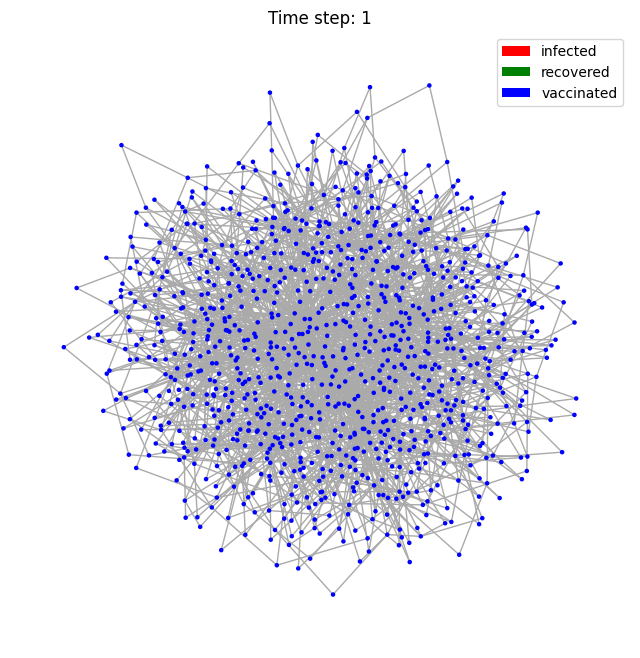

In [2]:
# pip install networkx -- if networkx not installed

import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import random
import IPython
from matplotlib.patches import Patch


# Parameters
num_nodes = 1000
num_edges = 2000 # not used in case of barabasi albert graph
num_steps = 1  # Number of frames in the animation

# Create an empty graph
G = nx.barabasi_albert_graph(num_nodes, 2)

# Initialize node states
for node in G.nodes():
    G.nodes[node]['state'] = 'infected'

# Precompute the positions of the nodes
pos = nx.spring_layout(G)

# creates a frame
def update_fig(num=1):
    """Update function for the animation."""
    update_states(num)
    ax.clear()
    colors = [color_map[G.nodes[node]['state']] for node in G.nodes()]
    labels = {node: G.nodes[node]['state'].capitalize() for node in G.nodes()}

    nx.draw(G, pos, ax=ax, node_color=colors,edge_color="#AAAAAA", with_labels=False, font_size=8, node_size=5)
    ax.set_title(f"Time step: {num}")

    plt.legend(handles=legend_labels, loc='upper right')
    # plt.title(f'Graph with {num_nodes} Nodes and {num_edges} Edges')

def update_states(current_step):
    """Randomly change the state of some nodes to simulate dynamics."""
    # for node in G.nodes():
    #     G.nodes[node]['state'] = random.choice(['infected', 'recovered', 'vaccinated'])

    nodes_per_step = num_nodes // num_steps
    # Nodes transitioning from 'infected' to 'vaccinated'
    for i, node in enumerate(G.nodes()):
        if G.nodes[node]['state'] == 'infected' and i < nodes_per_step * current_step:
            G.nodes[node]['state'] = 'vaccinated'
    # Nodes transitioning from 'vaccinated' to 'recovered'
    for i, node in enumerate(G.nodes()):
        if G.nodes[node]['state'] == 'vaccinated' and i < nodes_per_step * (current_step - 5):
            G.nodes[node]['state'] = 'recovered'


# Define color map
color_map = {
    'infected': 'red',
    'recovered': 'green',
    'vaccinated': 'blue'
}
legend_labels = [Patch(facecolor=color, label=label) for label, color in color_map.items()]

fig, ax = plt.subplots(figsize=(8, 8))
fig = update_fig()

# this function call update_fig for the defined number of timesteps
# ani = FuncAnimation(fig, update_fig, frames=num_steps, repeat=False)

# if want to save the mp4 file
# ani.save('network_animation.mp4', writer='ffmpeg')
# IPython.display.HTML(ani.to_jshtml()) 
# Display the animation
plt.show()


In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import os

# Parameters
num_nodes = 1000

# Create an empty graph
G = nx.barabasi_albert_graph(num_nodes, 2)

# Different position layouts
layouts = {
    'spring_layout': nx.spring_layout(G),
    'circular_layout': nx.circular_layout(G),
    'random_layout': nx.random_layout(G),
    'shell_layout': nx.shell_layout(G),
    'kamada_kawai_layout': nx.kamada_kawai_layout(G),
    'spectral_layout': nx.spectral_layout(G)
}
directory = "Node_position_layouts"

if not os.path.exists(directory):
    # Create the directory
    os.makedirs(directory)

# Create and save plots for each layout
for layout_name, positions in layouts.items():
    plt.figure(figsize=(8, 8))
    nx.draw(G, pos=positions, with_labels=False, node_color='skyblue', edge_color='gray', node_size=5)
    # plt.title(f' {layout_name.replace("_", " ").title()}')
    plt.savefig(f'{directory}/Network_graphs_{layout_name}_{num_nodes}_nodes.png')  # Save to local storage

# Return the file paths
file_paths = [f'{directory}/Network_graphs_{layout_name}_{num_nodes}_nodes.png' for layout_name in layouts.keys()]
file_paths


Draw differnt random graphs with differnt node position layouts

/tmp/ipykernel_93726/3144575127.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 8))


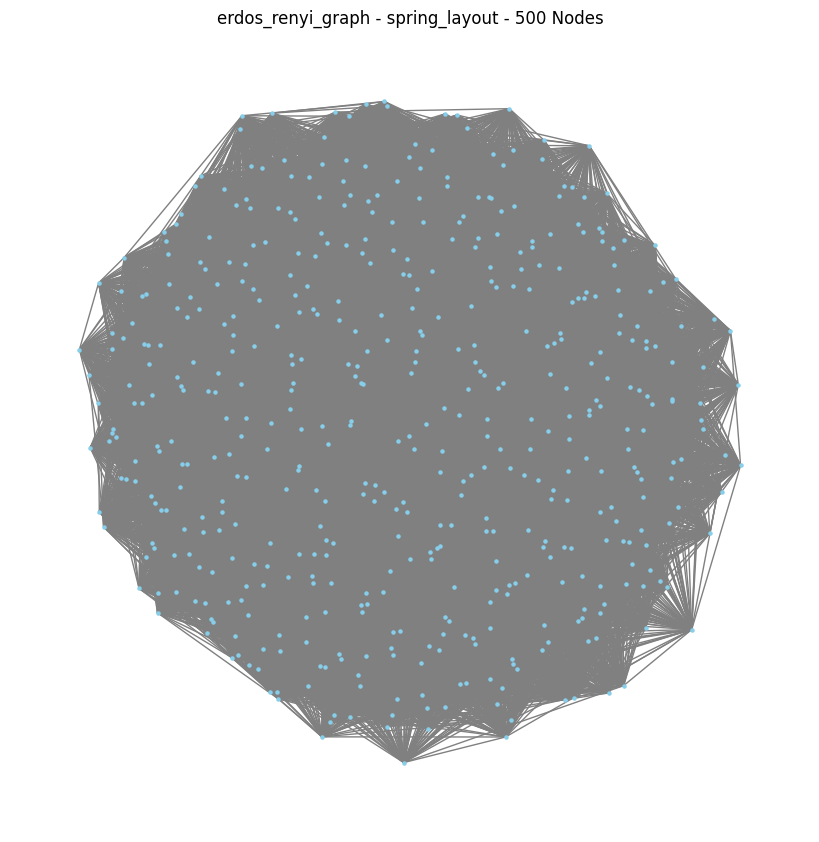

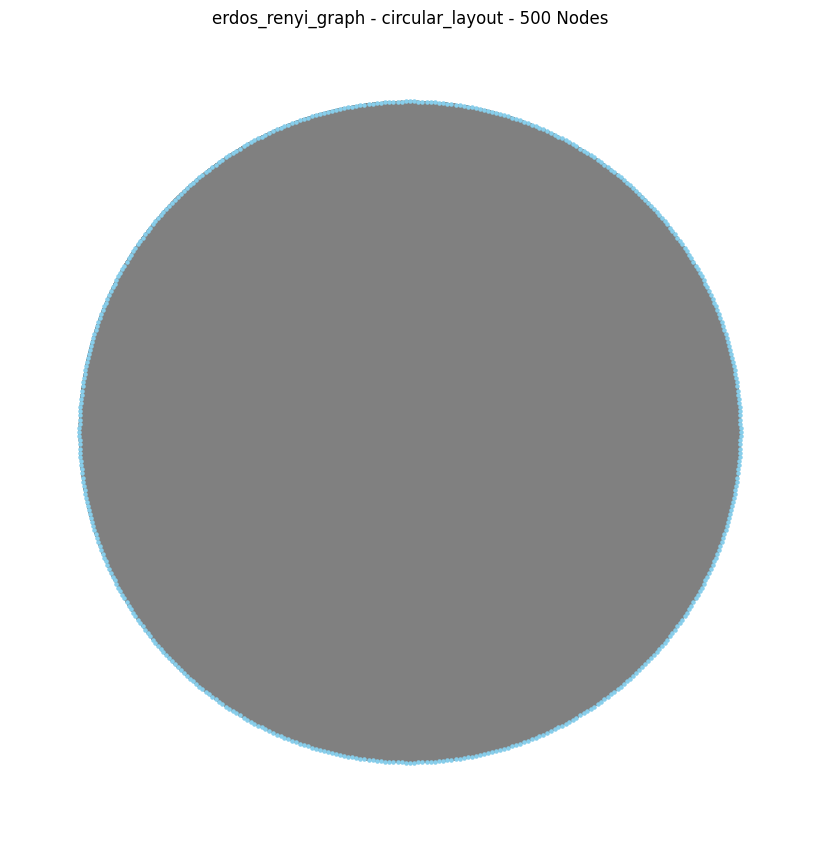

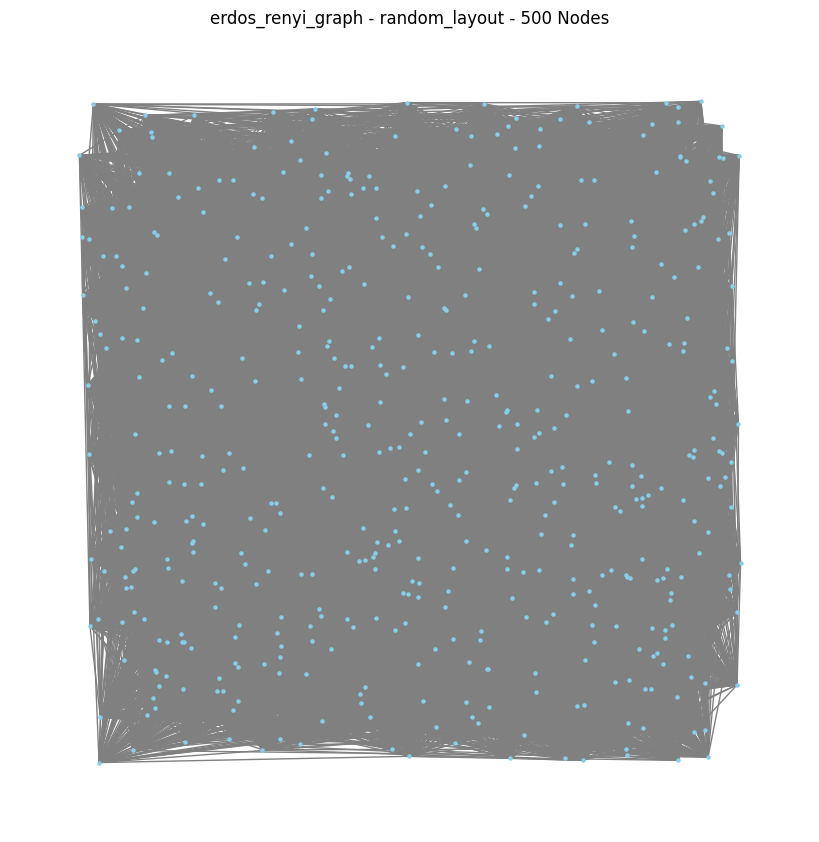

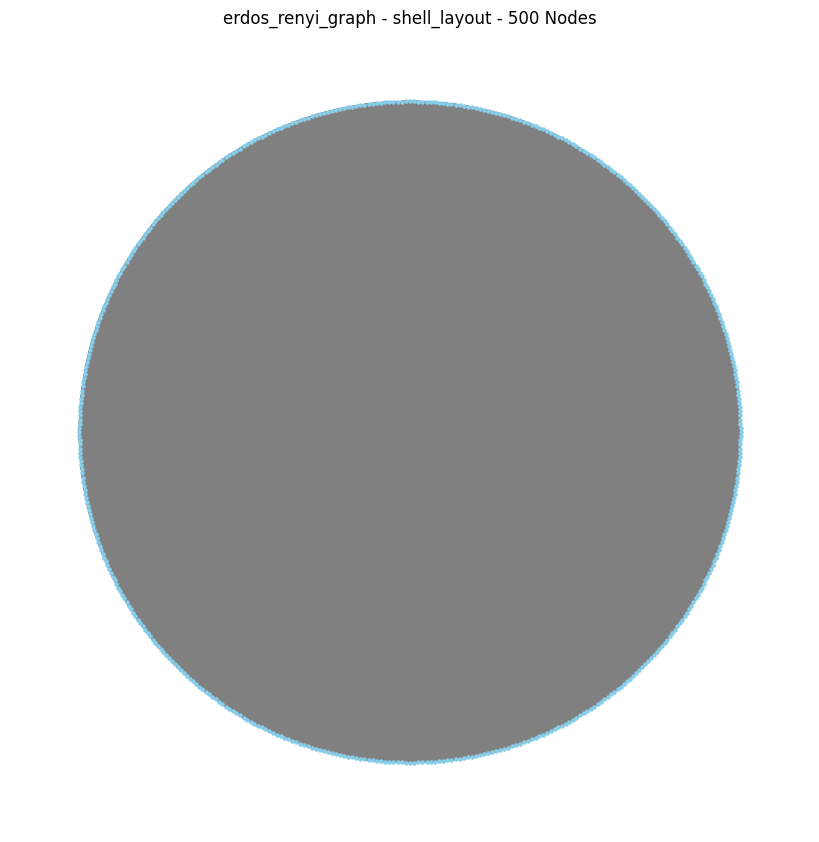

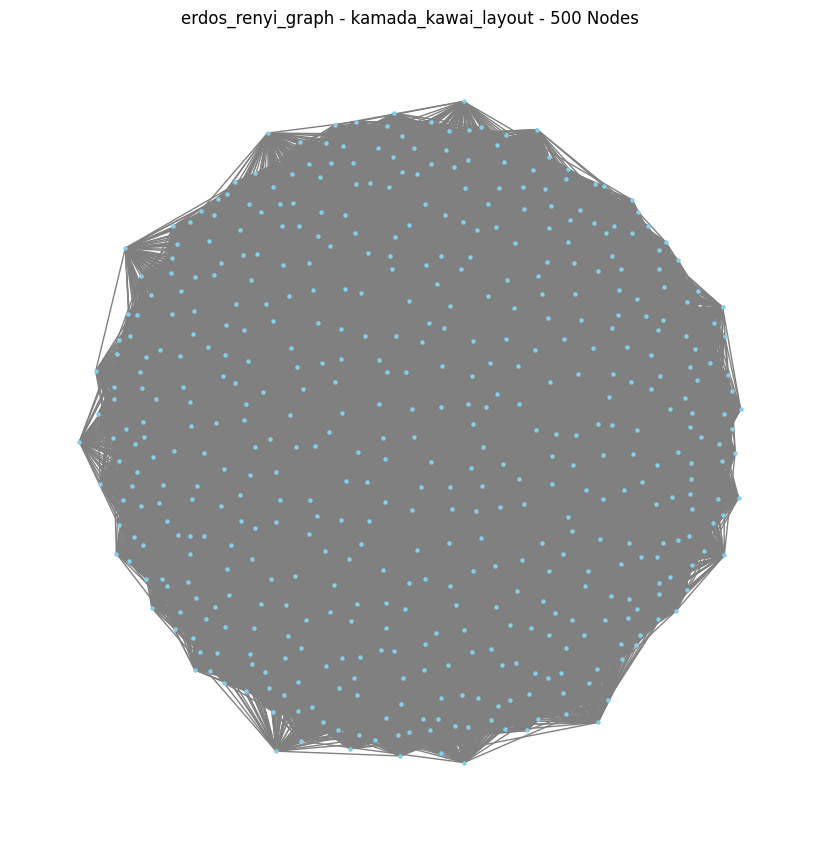

...

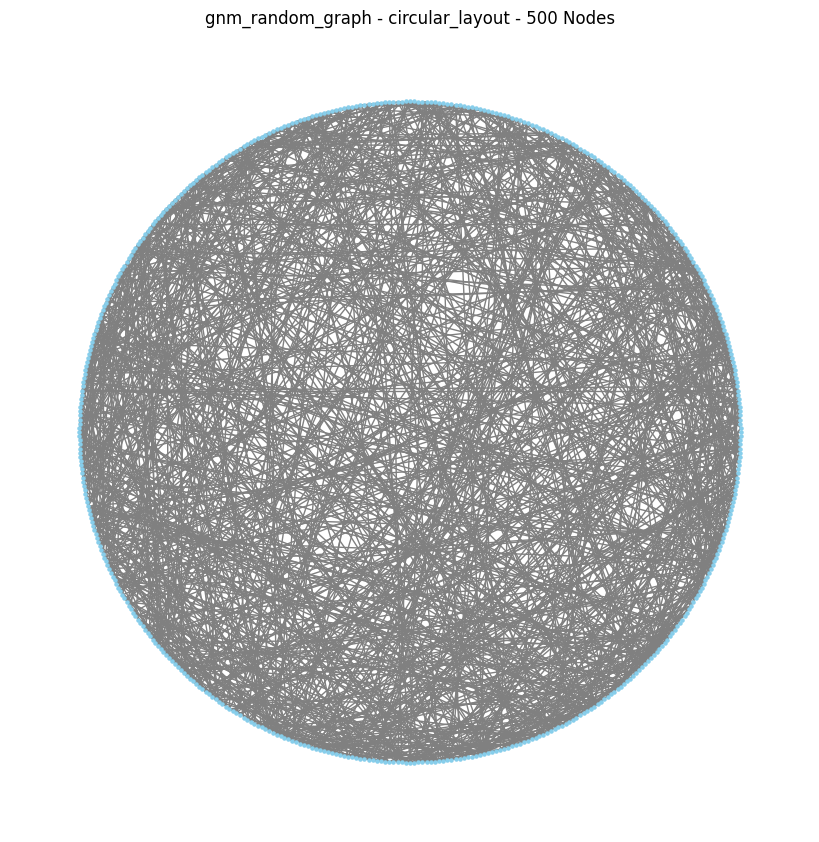

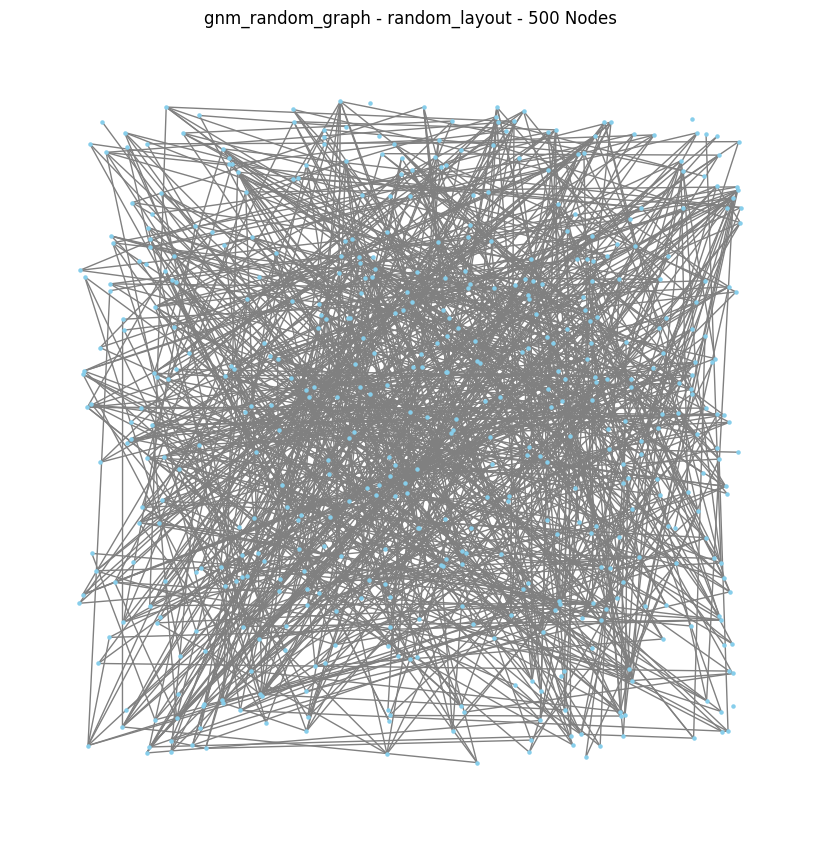

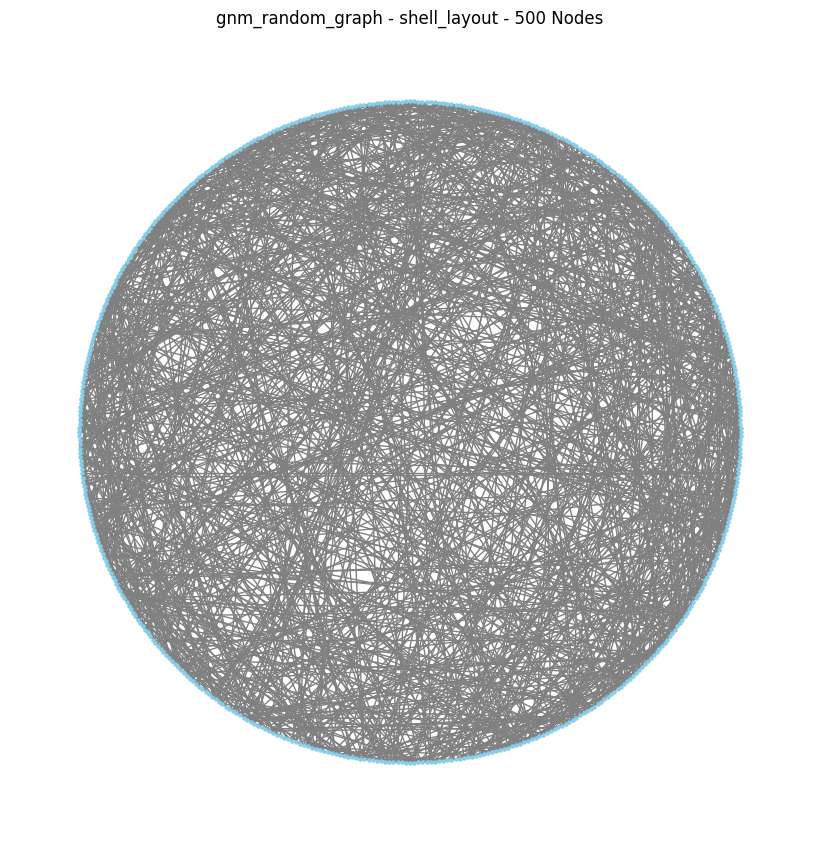

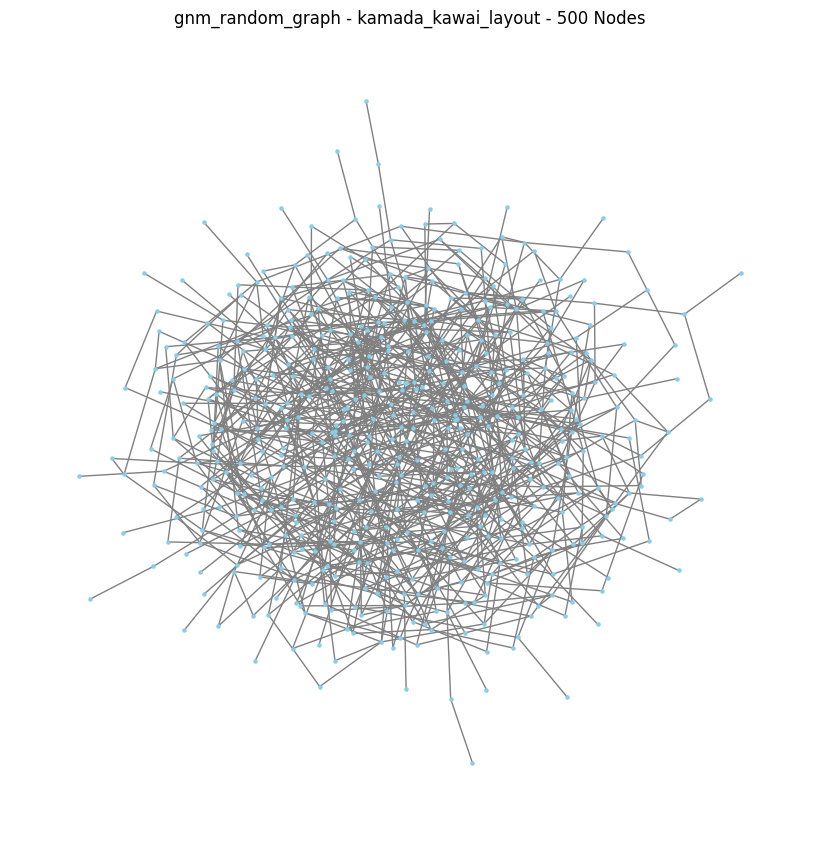

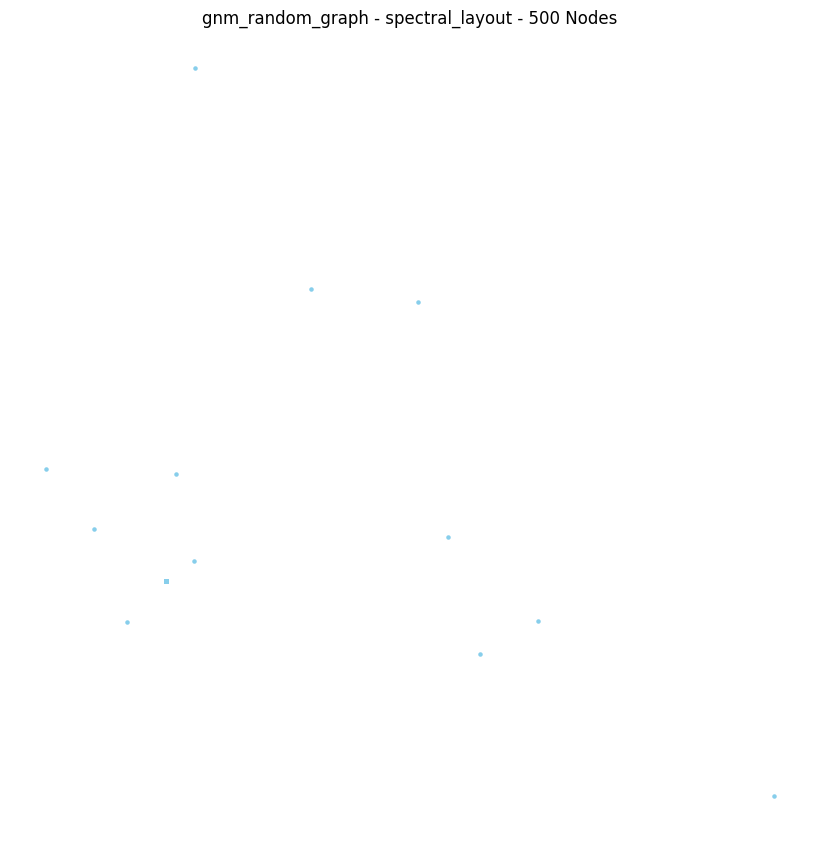

In [25]:
import networkx as nx
import matplotlib.pyplot as plt

num_nodes = 500
num_edges = 1000
# Define different types of random graphs
graphs = {
    'erdos_renyi_graph': nx.erdos_renyi_graph(n=num_nodes, p=0.2),
    'watts_strogatz_graph': nx.watts_strogatz_graph(n=num_nodes, k=4, p=0.2),
    'barabasi_albert_graph': nx.barabasi_albert_graph(n=num_nodes, m=2),
    'newman_watts_strogatz_graph': nx.newman_watts_strogatz_graph(n=num_nodes, k=4, p=0.2),
    'random_regular_graph': nx.random_regular_graph(d=3, n=num_nodes),
    'gnm_random_graph': nx.gnm_random_graph(n=num_nodes,m=num_edges)
}

# Define position layouts
layouts = {
    'spring_layout': nx.spring_layout,
    'circular_layout': nx.circular_layout,
    'random_layout': nx.random_layout,
    'shell_layout': nx.shell_layout,
    'kamada_kawai_layout': nx.kamada_kawai_layout,
    'spectral_layout': nx.spectral_layout
}
directory = "Random_graphs_node_position_layouts"

if not os.path.exists(directory):
    # Create the directory
    os.makedirs(directory)

# Generate and save plots for each graph type and layout
for graph_name, graph in graphs.items():
    for layout_name, layout_func in layouts.items():
        pos = layout_func(graph)  # Get positions based on layout
        plt.figure(figsize=(8, 8))
        nx.draw(graph, pos=pos, with_labels=False, node_color='skyblue', edge_color='gray', node_size=5)
        plt.title(f'{graph_name} - {layout_name} - {num_nodes} Nodes')
        file_path = f'{directory}/{graph_name}_{layout_name}_{num_nodes}_nodes.png'
        plt.savefig(file_path, bbox_inches='tight')  # Save to local storage
        # plt.close()



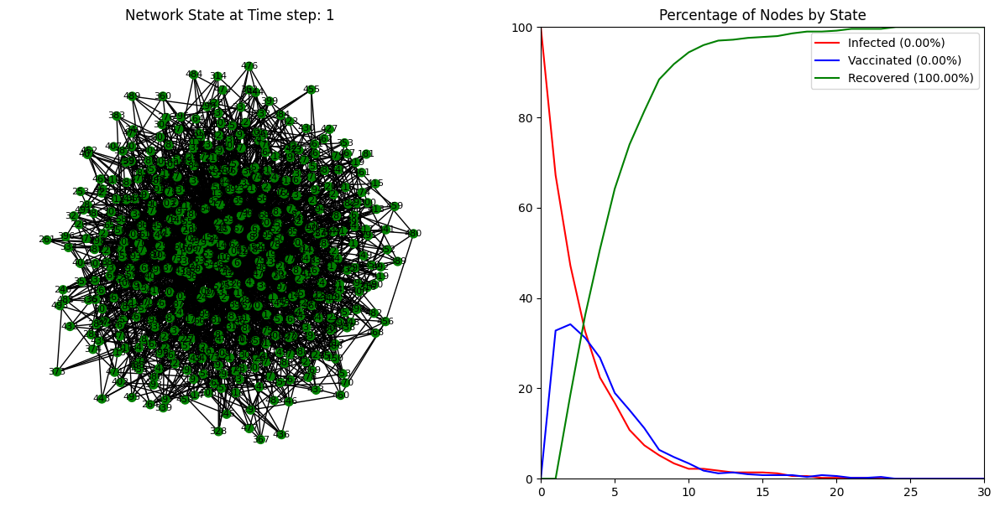

In [2]:
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import random
from matplotlib.patches import Patch
import IPython

# Parameters
num_nodes = 500
num_edges = 200
num_steps = 30  # Number of frames in the animation

# Create an empty graph
G = nx.barabasi_albert_graph(num_nodes, 5)

# Initialize all nodes to 'infected'
for node in G.nodes():
    G.nodes[node]['state'] = 'infected'

# Precompute the positions of the nodes
pos = nx.spring_layout(G)

# Prepare to track the state counts
state_counts = {'infected': [100.0], 'vaccinated': [0.0], 'recovered': [0.0]}

def update_states(current_step):
    """Update node states to simulate disease recovery dynamics."""
    nodes_per_step = num_nodes // num_steps
    for node in G.nodes():
        if G.nodes[node]['state'] == 'infected' and random.random() < 0.3:  # 30% chance to transition
            G.nodes[node]['state'] = 'vaccinated'
        elif G.nodes[node]['state'] == 'vaccinated' and random.random() < 0.5:  # 50% chance to transition
            G.nodes[node]['state'] = 'recovered'

    # Update the counts for the plot
    infected_count = sum(1 for node in G.nodes() if G.nodes[node]['state'] == 'infected')
    vaccinated_count = sum(1 for node in G.nodes() if G.nodes[node]['state'] == 'vaccinated')
    recovered_count = sum(1 for node in G.nodes() if G.nodes[node]['state'] == 'recovered')
    state_counts['infected'].append(100 * infected_count / num_nodes)
    state_counts['vaccinated'].append(100 * vaccinated_count / num_nodes)
    state_counts['recovered'].append(100 * recovered_count / num_nodes)

def update_fig(num):
    """Update function for the animation."""
    update_states(num)
    ax1.clear()
    ax2.clear()

    # Update the network graph
    colors = [color_map[G.nodes[node]['state']] for node in G.nodes()]
    nx.draw(G, pos, ax=ax1, node_color=colors, with_labels=True, font_size=8, node_size=50)

    # Update the plot of percentages
    for state, color in color_map.items():
        ax2.plot(state_counts[state], color=color, label=f'{state.capitalize()} ({state_counts[state][-1]:.2f}%)')

    # Update titles and legends
    ax1.set_title(f"Network State at Time step: {num + 1}")
    ax2.set_title("Percentage of Nodes by State")
    ax2.legend(loc='upper right')
    ax2.set_ylim(0, 100)
    ax2.set_xlim(0, num_steps)

# Define color map and create a corresponding legend
color_map = {
    'infected': 'red',
    'vaccinated': 'blue',
    'recovered': 'green'
}
legend_labels = [Patch(facecolor=color, label=label) for label, color in color_map.items()]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))
ani = FuncAnimation(fig, update_fig, frames=num_steps, repeat=False)

IPython.display.HTML(ani.to_jshtml()) 